In [25]:
import pandas as pd
import numpy as np 
import geopandas as gpd
import dask
from shapely.geometry import Point
import dask.dataframe as dd
from dask.delayed import delayed
import osmnx as ox
import contextily as ctx
import matplotlib.pyplot as plt
import re

In [2]:
df = dd.read_parquet("20181024_d2_0830_0900-points.parquet")
df = df.drop(columns=["secs", "speed", "long_acc", "lat_acc"])

In [3]:
df.head()

,ID,type,lon,lat
0,102483021,Car,23.733515,37.979512
1,102483021,Car,23.733512,37.979516
2,102483021,Car,23.733508,37.979520
3,102483021,Car,23.733505,37.979525
4,102483021,Car,23.733502,37.979529


In [4]:
# Get the bbox for the specific streets of athens
latmin, latmax, lonmin, lonmax = dd.compute(df.lat.min(), df.lat.max(),
                                             df.lon.min(), df.lon.max())
bbox = (latmax, latmin, lonmax, lonmin)
print(bbox)

(37.980008, 37.975462, 23.736808, 23.732031)


In [5]:
G = ox.graph.graph_from_bbox(latmax, latmin, lonmax, lonmin)

### Original Coordinate using EPSG:4326

In [6]:
G_df = ox.graph_to_gdfs(G, nodes=False, edges=True)
G_df.head()

osmid  oneway lanes                  name  \
u        v          key                                                  
42239277 250691695  0    167920360    True     4  Ελευθερίου Βενιζέλου   
         2317409162 0    222798493   False   NaN                   NaN   
         954712414  0    222798493   False   NaN                   NaN   
42240105 250691266  0    789796816    True   NaN    Καραγιώργη Σερβίας   
         954712431  0     23182767    True     6   Πλατεία Συντάγματος   

                             highway maxspeed  length  ref  \
u        v          key                                      
42239277 250691695  0        primary       50   8.015  NaN   
         2317409162 0        footway      NaN  12.167  NaN   
         954712414  0        footway      NaN   8.446  NaN   
42240105 250691266  0    residential      NaN  26.975  NaN   
         954712431  0        primary      NaN  62.233  ΕΟ1   

                                                                  geometry  \
u        v          key                                                      
42239277 250691695  0    LINESTRING (23.73567 37.97717, 23.73561 37.97722)   
         2317409162 0    LINESTRING (23.73567 37.97717, 23.73578 37.97723)   
         954712414  0    LINESTRING (23.73567 37.97717, 23.73559 37.97712)   
42240105 250691266  0    LINESTRING (23.73438 37.97620, 23.73408 37.97626)   
         954712431  0    LINESTRING (23.73438 37.97620, 23.73430 37.976...   

                        service tunnel access width  
u        v          key                              
42239277 250691695  0       NaN    NaN    NaN   NaN  
         2317409162 0       NaN    NaN    NaN   NaN  
         954712414  0       NaN    NaN    NaN   NaN  
42240105 250691266  0       NaN    NaN    NaN   NaN  
         954712431  0       NaN    NaN    NaN   NaN

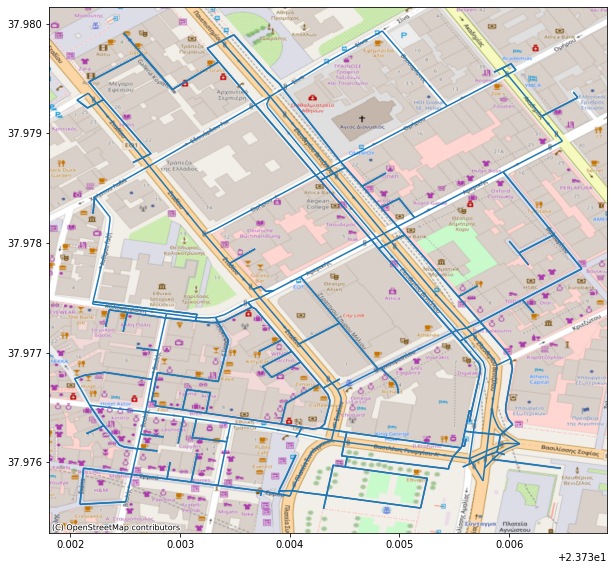

In [7]:
ax = G_df.plot(figsize=(10,10))
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:4326')

### Modified Coordinate using EPSG:32634 (UTM)

In [8]:
# Project to UTM to use metric system
G_df_UTM = ox.projection.project_gdf(G_df)
G_df_UTM.head()

osmid  oneway lanes                  name  \
u        v          key                                                  
42239277 250691695  0    167920360    True     4  Ελευθερίου Βενιζέλου   
         2317409162 0    222798493   False   NaN                   NaN   
         954712414  0    222798493   False   NaN                   NaN   
42240105 250691266  0    789796816    True   NaN    Καραγιώργη Σερβίας   
         954712431  0     23182767    True     6   Πλατεία Συντάγματος   

                             highway maxspeed  length  ref  \
u        v          key                                      
42239277 250691695  0        primary       50   8.015  NaN   
         2317409162 0        footway      NaN  12.167  NaN   
         954712414  0        footway      NaN   8.446  NaN   
42240105 250691266  0    residential      NaN  26.975  NaN   
         954712431  0        primary      NaN  62.233  ΕΟ1   

                                                                  geometry  \
u        v          key                                                      
42239277 250691695  0    LINESTRING (740281.095 4206812.833, 740276.093...   
         2317409162 0    LINESTRING (740281.095 4206812.833, 740291.090...   
         954712414  0    LINESTRING (740281.095 4206812.833, 740274.141...   
42240105 250691266  0    LINESTRING (740171.105 4206702.309, 740144.720...   
         954712431  0    LINESTRING (740171.105 4206702.309, 740163.879...   

                        service tunnel access width  
u        v          key                              
42239277 250691695  0       NaN    NaN    NaN   NaN  
         2317409162 0       NaN    NaN    NaN   NaN  
         954712414  0       NaN    NaN    NaN   NaN  
42240105 250691266  0       NaN    NaN    NaN   NaN  
         954712431  0       NaN    NaN    NaN   NaN

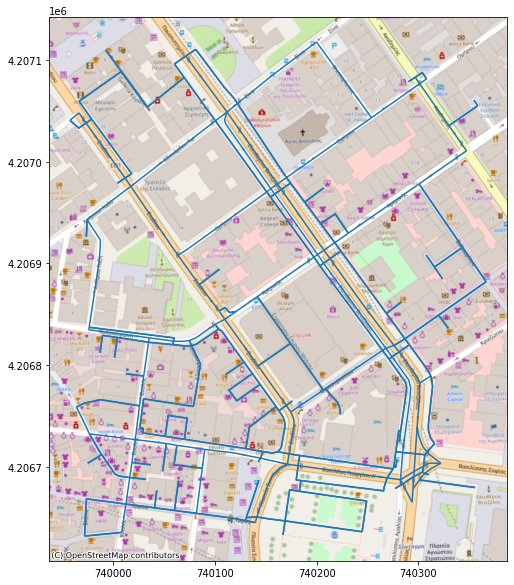

In [9]:
ax = G_df_UTM.plot(figsize=(10,10))
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, crs='EPSG:32634')

In [10]:
print(f'Original projection: {G_df.crs.srs}')
print(f'UTM projection: {G_df_UTM.estimate_utm_crs().srs}')

Original projection: epsg:4326
UTM projection: epsg:32634


We ploted this in order to see if there was some change on the type of format for the coordinates and the projection, as we see there was not change. <br>
However our teacher request us to do it, which is present later.

### Computing the geometry in each format. 
Creating the Geodataframe to work with geometry


In [65]:
#data = pd.DataFrame(df)
data = df.compute()

### First done using epsg:4326 (Original Format)

In [66]:
df_4326=data.copy()
df_4326.head()

,ID,type,lon,lat
0,102483021,Car,23.733515,37.979512
1,102483021,Car,23.733512,37.979516
2,102483021,Car,23.733508,37.979520
3,102483021,Car,23.733505,37.979525
4,102483021,Car,23.733502,37.979529


In [67]:
import holoviews as hv
import geoviews as gv
from holoviews.element.tiles import OSM
from holoviews.operation.datashader import datashade
import colorcet as cc

In [68]:
df_streets = G_df.reset_index()['geometry']
df_streets.head()

0    LINESTRING (23.73567 37.97717, 23.73561 37.97722)
1    LINESTRING (23.73567 37.97717, 23.73578 37.97723)
2    LINESTRING (23.73567 37.97717, 23.73559 37.97712)
3    LINESTRING (23.73438 37.97620, 23.73408 37.97626)
4    LINESTRING (23.73438 37.97620, 23.73430 37.976...
Name: geometry, dtype: geometry

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
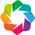

:DynamicMap   []
   :Overlay
      .RGB.I  :RGB   [lon,lat]   (R,G,B,A)
      .Path.I :Path   [x,y]

In [15]:
hv.extension('bokeh')
#map_tiles  = OSM().opts(alpha=1, width=600, height=700)
streets  = hv.Path(df_streets).opts(line_width=4, width=1200, height=1400, alpha=0.7)
points   = hv.Points(df_4326, ["lon", "lat"]).opts(width=1200, height=1400)
shader = datashade(points, cmap=cc.fire, width=1200, height=1400)

shader * streets

### Second done using epsg:32634 (UTM Format)

In [72]:
df_32634 =data.copy()
df_32634.head()

,ID,type,lon,lat
0,102483021,Car,23.733515,37.979512
1,102483021,Car,23.733512,37.979516
2,102483021,Car,23.733508,37.979520
3,102483021,Car,23.733505,37.979525
4,102483021,Car,23.733502,37.979529


In [73]:
points32634 = gpd.points_from_xy(df_32634["lon"],df_32634["lat"], crs="EPSG:32634")

In [74]:
df_32634["geometry"] = points32634

In [75]:
df_32634["geometry"] = df_32634.geometry.astype(str)

In [76]:
df_32634["geometry"] = df_32634.geometry.str.replace("POINT ", "")

In [77]:
df_32634["geometry"] = df_32634.geometry.str.replace("(", "")

<ipython-input-77-ec44a494d6c5>:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will*not* be treated as literal strings when regex=True.
  df_32634["geometry"] = df_32634.geometry.str.replace("(", "")


In [78]:
df_32634["geometry"] = df_32634.geometry.str.replace(")", "")

<ipython-input-78-952965c99fcf>:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will*not* be treated as literal strings when regex=True.
  df_32634["geometry"] = df_32634.geometry.str.replace(")", "")


In [79]:
def epsg_32634_lat(string):
    regex = "((\d)+\.+(\d)+)"
    lat = float(re.findall(regex, string)[0][0])
    return lat
def epsg_32634_lon(string):
    regex = "((\d)+\.+(\d)+)"
    lon = float(re.findall(regex, string)[1][0])
    return lon

In [80]:
df_32634["lat_32634"] = df_32634.geometry.apply(epsg_32634_lat)
df_32634["lon_32634"] = df_32634.geometry.apply(epsg_32634_lon)

In [81]:
df_32634.drop(columns=["lon", "lat", "geometry"], inplace=True)

In [82]:
df_32634.head()

,ID,type,lat_32634,lon_32634
0,102483021,Car,23.7335,37.9795
1,102483021,Car,23.7335,37.9795
2,102483021,Car,23.7335,37.9795
3,102483021,Car,23.7335,37.9795
4,102483021,Car,23.7335,37.9795


In [84]:
df_streets_34 = G_df_UTM.reset_index()[['geometry']]
df_streets_34.head()

,geometry
0,"LINESTRING (740281.095 4206812.833, 740276.093..."
1,"LINESTRING (740281.095 4206812.833, 740291.090..."
2,"LINESTRING (740281.095 4206812.833, 740274.141..."
3,"LINESTRING (740171.105 4206702.309, 740144.720..."
4,"LINESTRING (740171.105 4206702.309, 740163.879..."


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
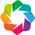

:DynamicMap   []
   :Overlay
      .RGB.I  :RGB   [lat_32634,lon_32634]   (R,G,B,A)
      .Path.I :Path   [x,y]

In [87]:
hv.extension('bokeh')
#map_tiles  = OSM().opts(alpha=1, width=600, height=700)
streets  = hv.Path(df_streets_34).opts(line_width=4, width=1200, height=1400, alpha=0.7)
points   = hv.Points(df_32634, ['lat_32634','lon_32634']).opts(width=1200, height=1400)
shader = datashade(points, cmap=cc.fire, width=1200, height=1400)

shader * streets